In [ ]:
# !unzip 'drive/My Drive/Dog Vision/dog-breed-identification.zip' -d 'drive/My Drive/Dog Vision/'

# Get Our Data Ready

In [81]:
# import tensorflow 
import tensorflow as tf
import tensorflow_hub as hub
print('TF Hub version: ', hub.__version__)
print('TF version:', tf.__version__)

# check for GPU availability
print('GPU', 'available (YESSS!!)' if tf.config.list_physical_devices('GPU') else 'not available')

TF Hub version:  0.12.0
TF version: 2.4.1
GPU available (YESSS!!)


## Getting our data ready

In [82]:
import pandas as pd
labels_csv = pd.read_csv('drive/My Drive/Dog Vision/labels.csv')
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     ed8a0ac4b8566dec190f7308933a1d62  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


In [83]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


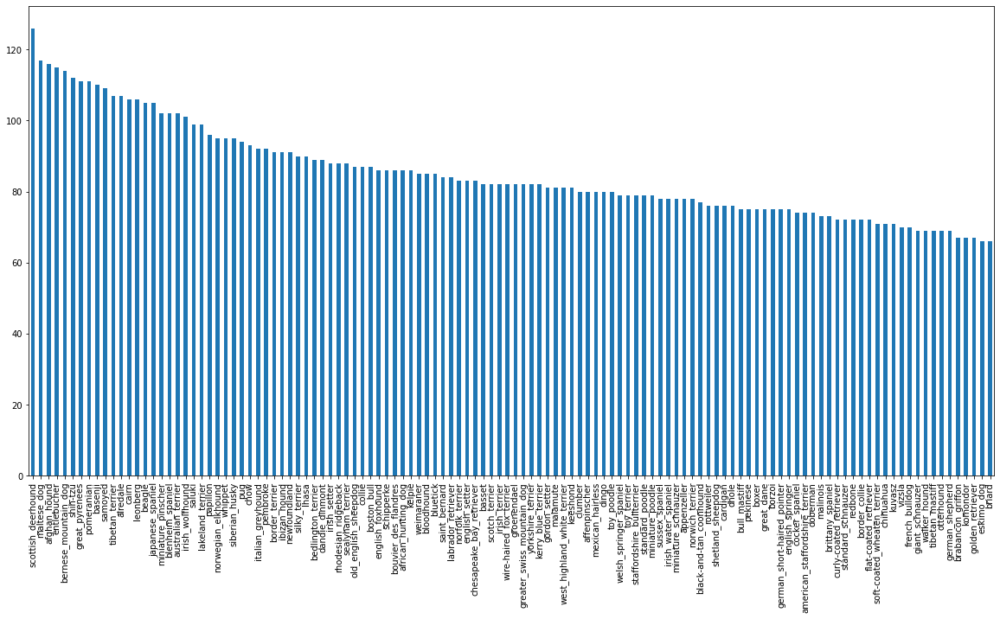

In [84]:
# how many images of each breed
labels_csv['breed'].value_counts().plot.bar(figsize=(20,10))

In [85]:
labels_csv['breed'].value_counts().median()

82.0

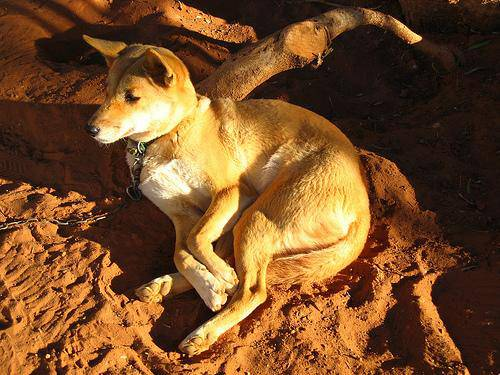

In [86]:
# let's view an image
from IPython.display import Image
Image('drive/My Drive/Dog Vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg')

### Getting images and their Labels

In [87]:
# create pathnames from images ID's
filenames = ['drive/My Drive/Dog Vision/train/' + fname for fname in labels_csv['id']+'.jpg']

In [88]:
filenames[:5]

['drive/My Drive/Dog Vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/My Drive/Dog Vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/My Drive/Dog Vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/My Drive/Dog Vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/My Drive/Dog Vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg']

In [89]:
# check whether number of filenames with actual images
import os
if len(os.listdir('drive/My Drive/Dog Vision/train/'))== len(filenames):
  print('same')

same


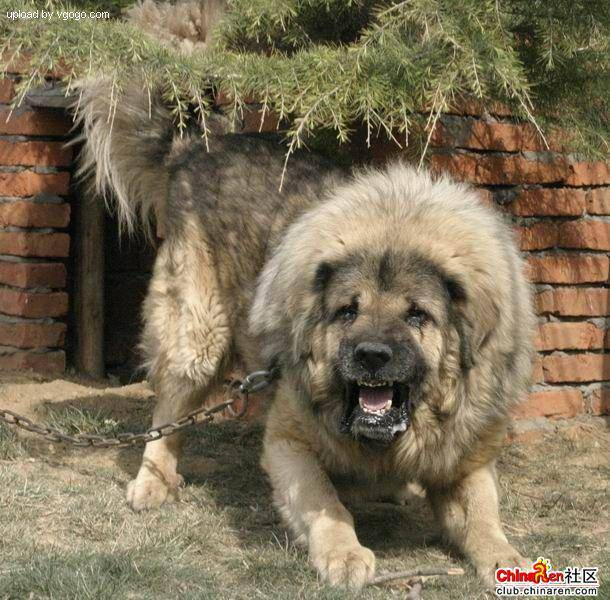

In [90]:
Image(filenames[9000])

In [91]:
labels_csv['breed'][9000]

'tibetan_mastiff'

In [92]:
import numpy as np
labels = labels_csv['breed']
labels = np.array(labels)
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [93]:
len(labels)

10222

In [94]:
if len(labels) == len(filenames):
  print('same')

same


In [95]:
unique_breeds = np.unique(labels)
len(unique_breeds)

120

In [96]:
# turn a single into an array
print(labels[0])
labels[0] == unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [97]:
# turn every label into a boolean array
boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [98]:
len(boolean_labels)

10222

In [99]:
# example: turn boolean array into int
print(labels[0])
print(np.where(unique_breeds == labels[0]))
print(boolean_labels[0].argmax())
print(boolean_labels[0].astype(int))

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


### Creating our validation set 

In [100]:
# set up x and y
x = filenames
y = boolean_labels

start with 1000 images 

In [ ]:
# set number of images to use for experimenting

NUM_IMAGES = 10000 #@param {type:'slider', min:1000, max:10000, step:1000}

In [ ]:
# split data into train and validation
from sklearn.model_selection import train_test_split

x_train, x_val, y_train, y_val = train_test_split(x[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size = 0.2,
                                                  random_state=42)

len(x_train), len(y_train), len(x_val), len(y_val)

(8000, 8000, 2000, 2000)

In [ ]:
x_train[:2], y_train[:2]

(['drive/My Drive/Dog Vision/train/e86be20abe3ab746179728fa6f19bc59.jpg',
  'drive/My Drive/Dog Vision/train/269a6aeefd8050aafda02044c9cd2a80.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
          True, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, F

## Prepocessing images(turning images into tensors)

In [ ]:
# convert image to Numpy array
from matplotlib.pyplot import imread
image = imread(filenames[42])
image.shape

(257, 350, 3)

In [ ]:
tf.constant(image)

<tf.Tensor: shape=(257, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]],

       [[ 56, 104,  66],
        [ 58, 106,  66],
        [ 64, 112,  72],
        ...,
        [ 71, 127,  82],
        [ 73, 129,  84],
        [ 73, 130,  85]],

       ...,

       [[  2,  11,  10],
        [  5,  14,  13],
        [  6,  15,  14],
        ...,
        [120, 113,  67],
        [126, 118,  72],
        [122, 114,  67]],

       [[  0,   4,   6],
        [  0,   9,   8],
        [  1,  10,   9],
        ...,
        [105,  98,  52],
        [111, 104,  58],
        [111, 103,  56]],

       [[ 18,  16,  37],
        [ 18,  18,  28],
        [ 17,  20,  11],
        ...,
        [101,  92,  5

In [ ]:
IMG_SIZE = 224

# function for preprocessing image
def process_image(image_path, img_size = IMG_SIZE):
  """
  Takes images file path and turns image into a Tensor
  """
  # read image file
  image = tf.io.read_file(image_path)
  # turn image into tensor with 3 color channels RGB
  image = tf.image.decode_jpeg(image, channels=3)
  # convert the color channel values to from 0 to 255 to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)
  # resize the image (224, 224)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])

  return image

## Turning data into batches

In [101]:
# create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes an image file path name and associated label
  processes the image and returns a tuple of (image. label)
  """
  image = process_image(image_path)
  return image,label

In [ ]:
(process_image(x[42]), tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

## Trun data into batches

In [102]:
# define the batch size 32
BATCH_SIZE = 32

# create a function to turn data into batches
def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  create batches of data out of image (x) and label (y) pairs.
  shuffles the data if it's training data but doesn't shuffle if it's validation data
  test data as input also (no labels)
  """
  # data is a test dataset, no labels
  if test_data:
    print('creating test data batches ...')
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) # only filepaths no labels
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  # data is validation data set, don't shuffle
  elif valid_data:
    print('creating validation data batches ...')
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x),
                                               tf.constant(y)))
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    print('creating training data batches ...')
    # trun filepaths and labels into tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x),
                                              tf.constant(y)))
    
    # shuffle pathnames and labels efore mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size = len(x))
    # create (image, label) tupes also turns the image path into a prepocessed image
    data = data.map(get_image_label)
    # trun the training data into batches
    data_batch = data.batch(BATCH_SIZE)

    return data_batch


In [ ]:
# creating training and validation data batches
train_data = create_data_batches(x_train, y_train)
val_data = create_data_batches(x_val, y_val, valid_data=True)

creating training data batches ...
creating validation data batches ...


In [ ]:
# check out the diff attributes of data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visualizing Data Batches 

In [103]:
import matplotlib.pyplot as plt
def show_25_images(images, labels):
  """
  Displays a plot of 25 images and their labels from a data batch
  """
  # setup figure
  plt.figure(figsize=(10,10))
  # loop through 25 images
  for i in range(25):
    # create subplots (5rows, 5cols)
    ax = plt.subplot(5, 5, i+1)
    # display an image
    plt.imshow(images[i])
    # add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # turn the grid lilnes off
    plt.axis('off')

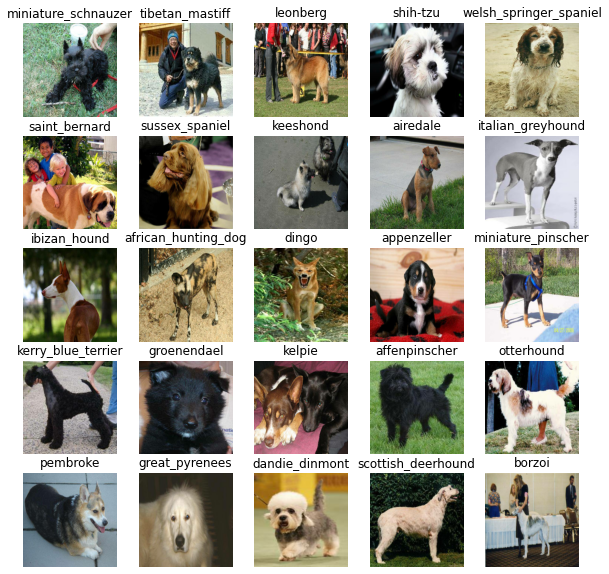

In [ ]:
# visualize data
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

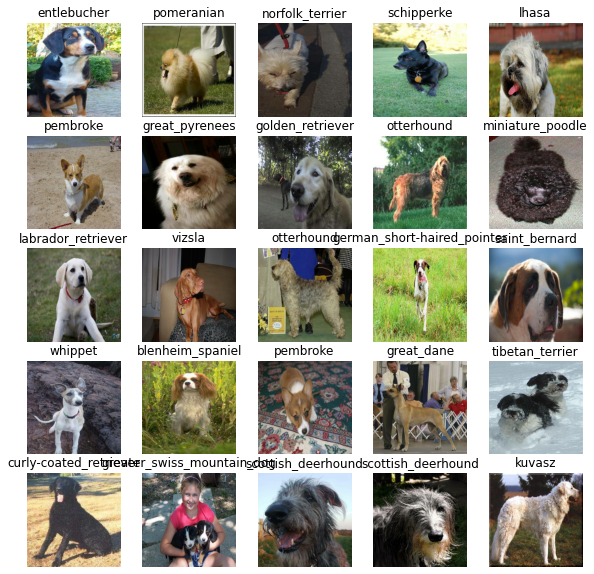

In [ ]:
# valdatation set
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

## Building a model

In [ ]:
# setup inupt shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, color channels

# Setup output shape
OUTPUT_SHAPE = len(unique_breeds)

# setup model URL from TensorFlow Hub
MODEL_URL = 'https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4'

Keras deep learning model

In [ ]:
# create a function which build a keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print('building model with: ', MODEL_URL)

  # setup model layers
  model = tf.keras.Sequential([
    hub.KerasLayer(MODEL_URL), #  Layer 1 (input layer)
    tf.keras.layers.Dense(units=OUTPUT_SHAPE, activation='softmax'), # layer 2 (output layer)
  ])

  # compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(),
      optimizer=tf.keras.optimizers.Adam(),
      metrics=['accuracy']
  )

  # build the model
  model.build(INPUT_SHAPE)

  return model

In [ ]:
model = create_model()
model.summary()

building model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1001)              5432713   
_________________________________________________________________
dense (Dense)                (None, 120)               120240    
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


In [ ]:
outputs = np.ones(shape=(1,1, 1280))
outputs

array([[[1., 1., 1., ..., 1., 1., 1.]]])

## callbacks

In [ ]:
# load TensorBoaed notebook extension
%load_ext tensorboard

In [ ]:
import datetime
# create a function to build a TensorBoard callback
def create_tensorflow_callback():
  # create a log directory to store TnsorBoard logs
  logdir = os.path.join('drive/My Drive/Dog Vision/logs',
                        datetime.datetime.now().strftime('%Y%m%d-%H%M%S'))
  return tf.keras.callbacks.TensorBoard(logdir)

###Early Stopping callback

In [ ]:
# create early stopping callback
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy',
                                                  patience=3)

## Training a Model(on subset of data)

In [ ]:
NUM_EPOCHS = 100 #@param {type:'slider', min:10,max:100,step:10}

In [ ]:
# function to train the model
def train_model():
  """
  Trains a givien model and retruns the trained version
  """
  model = create_model()

  # create new TensorBoard session everytime we train a model
  tensorboard = create_tensorflow_callback()

  # fit model to the data passing it the callbacks we created
  model.fit(x=train_data, 
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1,
            callbacks=[tensorboard, early_stopping])
  
  # return the fitted model
  return model

In [ ]:
# fit the model
model = train_model()

building model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
250/250 [==============================] - 2481s 10s/step - loss: 2.5940 - accuracy: 0.4400 - val_loss: 0.7245 - val_accuracy: 0.7815
Epoch 2/100
250/250 [==============================] - 37s 149ms/step - loss: 0.4085 - accuracy: 0.8879 - val_loss: 0.6583 - val_accuracy: 0.7970
Epoch 3/100
250/250 [==============================] - 37s 149ms/step - loss: 0.2185 - accuracy: 0.9503 - val_loss: 0.6494 - val_accuracy: 0.7995
Epoch 4/100
250/250 [==============================] - 37s 149ms/step - loss: 0.1442 - accuracy: 0.9711 - val_loss: 0.6423 - val_accuracy: 0.8065
Epoch 5/100
250/250 [==============================] - 37s 150ms/step - loss: 0.0917 - accuracy: 0.9871 - val_loss: 0.6589 - val_accuracy: 0.7980
Epoch 6/100
250/250 [==============================] - 37s 149ms/step - loss: 0.0678 - accuracy: 0.9908 - val_loss: 0.6568 - val_accuracy: 0.8050
Epoch 7/100
250/250 [=========

### checking the TonsorBoard logs


In [ ]:
%tensorboard --logdir drive/My\ Drive/Dog\ Vision/logs

<IPython.core.display.Javascript object>

## Making and evaluating predictions using trained model


In [ ]:
# make prediction on validation data(not used to train on)
predictions = model.predict(val_data,verbose=1)
predictions

63/63 [==============================] - 8s 126ms/step


array([[3.86817067e-09, 1.61997735e-10, 1.00027551e-08, ...,
        8.23759017e-09, 4.67947785e-07, 1.59137437e-09],
       [6.85978421e-07, 5.09003186e-08, 3.02437519e-10, ...,
        1.69942588e-10, 7.08903658e-10, 2.09403499e-08],
       [2.44621537e-04, 1.15969058e-04, 3.55126467e-05, ...,
        6.78416109e-06, 1.76781468e-04, 4.87606553e-03],
       ...,
       [2.15581767e-05, 1.59926021e-05, 1.27823853e-07, ...,
        4.75085908e-05, 1.44926735e-05, 9.21096187e-03],
       [3.90922992e-08, 1.04338174e-08, 4.11628598e-08, ...,
        3.88482164e-07, 1.51958331e-04, 8.40066718e-08],
       [6.68496227e-07, 2.32324062e-04, 7.92714250e-09, ...,
        2.02896704e-08, 1.98274711e-06, 2.73381083e-05]], dtype=float32)

In [ ]:
predictions.shape

(2000, 120)

In [ ]:
np.sum(predictions[0])

0.9999999

In [ ]:
np.sum(predictions[1])

1.0000001

In [ ]:
# frist prediction
print(unique_breeds[np.argmax(predictions[1])])

pomeranian


In [104]:
# turn predictions probabilities into their respective label
def get_pred_label(prediction_probabilities):
  """
  Turns an array of prection probabilities into a label
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

# get a predicted label 
pred_label = get_pred_label(predictions[0])
pred_label

'entlebucher'

In [105]:
# create a function to unbatch dataset
def unbatchify(data):
  """
  Takes a batched dataset of (image,label)Tensors and returns separete arrays of images and labels 
  """
  images = []
  labels = []
  # loop through unbatches data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

# unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_images[0]

(array([[[0.96884924, 0.9701885 , 0.6773138 ],
         [0.9649684 , 0.9649684 , 0.6752449 ],
         [0.97255224, 0.97255224, 0.68971497],
         ...,
         [0.94544876, 0.93533266, 0.63851905],
         [0.9122807 , 0.90027964, 0.59165734],
         [0.6266023 , 0.6167168 , 0.30141547]],
 
        [[0.9636907 , 0.9677085 , 0.69290984],
         [0.97148985, 0.97514886, 0.7090773 ],
         [0.9998248 , 0.99992114, 0.74782914],
         ...,
         [0.97280353, 0.9686894 , 0.715118  ],
         [0.9849285 , 0.99132735, 0.7000457 ],
         [0.8505023 , 0.86189073, 0.55982476]],
 
        [[0.94763345, 0.9589167 , 0.70516145],
         [0.96966976, 0.9795524 , 0.73575866],
         [0.9953722 , 0.99858195, 0.7804973 ],
         ...,
         [0.8728771 , 0.8872267 , 0.69398195],
         [0.8451019 , 0.8824005 , 0.6274633 ],
         [0.7930096 , 0.83910555, 0.5551244 ]],
 
        ...,
 
        [[0.47171637, 0.37899917, 0.3959688 ],
         [0.23060556, 0.1464493 , 0.15993

In [106]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction truth and image for sample n
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n],images[n]

  # get the pred label
  pred_label = get_pred_label(pred_prob)

  # plot image and remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # change the color of the title depending on the prediction right or wrong
  if pred_label == true_label:
    color = 'green'
  else:
    color = 'red'


  # change plot title
  plt.title('{} {:2.0f}% {}'.format(pred_label,
                                    np.max(pred_prob)*100,
                                    true_label),
            color=color)
  

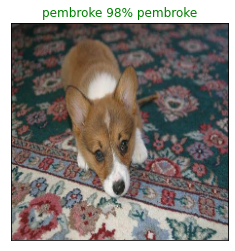

In [ ]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,
          n=17)

In [107]:
# plot the top 10 prediction probability values and labels
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plus the top 10 highest prediction confidences alnog with the truth label for sample n
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # get the predicted label
  pred_label = get_pred_label(pred_prob)

  # find top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]

  # find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]

  # find top 10 labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # set up plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                    top_10_pred_values,
                    color='grey')
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation='vertical')
  
  # change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color('green')
  else:
    pass

In [ ]:
predictions[0].argsort()[-10:][::-1]

array([ 42,   5,  53,   9,  12, 113,  15,  39,   4,   7])

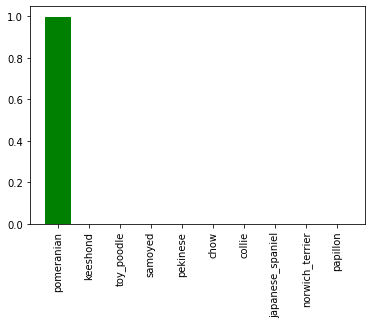

In [ ]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=1)

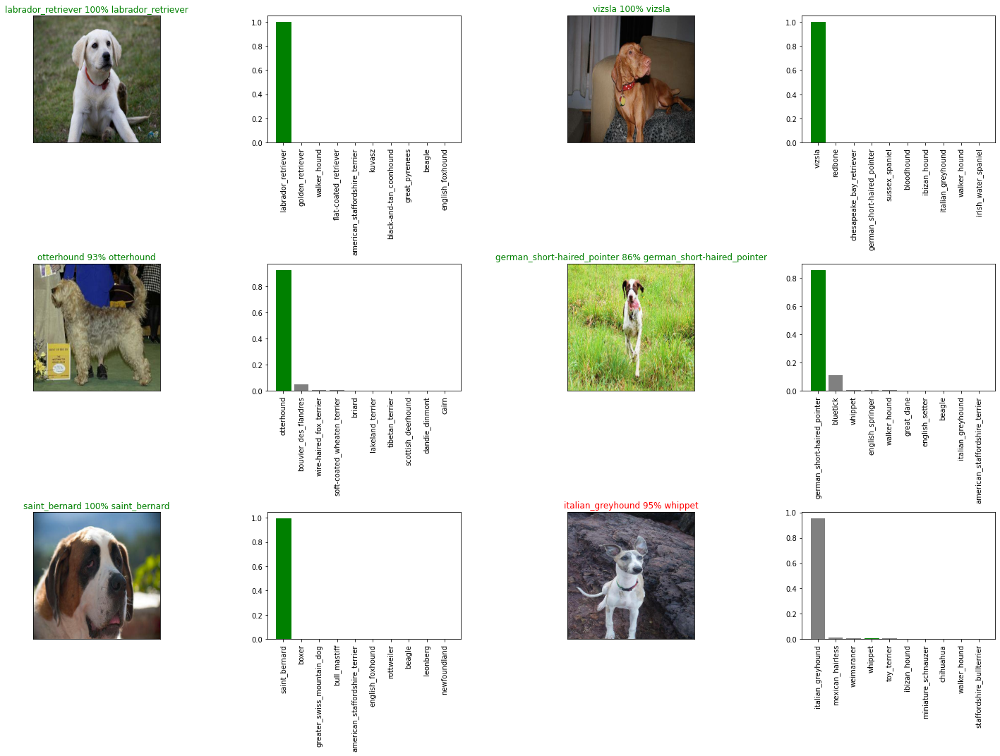

In [ ]:
i_multiplier = 10
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(10*num_cols,5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                 labels=val_labels,
                 n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

## Saving and reloading a trained model

In [ ]:
# create a function to save a model
def save_model(model, suffix=None):
  """
  Saves a givien model and appends a suffix
  """
  # create model directory pathname with curr time
  modeldir = os.path.join('drive/My Drive/Dog Vision/models',
                          datetime.datetime.now().strftime('%Y%m%d-%H%M%s'))
  model_path = modeldir+'-'+suffix+'.h5' # save format for model
  print(f'saving model to:{model_path}...')
  model.save(model_path)
  return model_path

In [120]:
# create a function to load a trained model
def load_model(model_path):
  """
  loads a saved model from a specified path
  """
  print(f'loading saved model from: {model_path}')
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={'KerasLayer':hub.KerasLayer})
  return model

In [ ]:
# save model trained on 1000 images
save_model(model, suffix = 'all-images-Adam-mobilenetv2')

saving model to:drive/My Drive/Dog Vision/models/20210419-11461618832769-all-images-Adam-mobilenetv2.h5...


'drive/My Drive/Dog Vision/models/20210419-11461618832769-all-images-Adam-mobilenetv2.h5'

In [121]:
# load trained model
loaded_all_image_model = load_model('/content/drive/MyDrive/Dog Vision/models/20210419-11461618832769-all-images-Adam-mobilenetv2.h5')

loading saved model from: /content/drive/MyDrive/Dog Vision/models/20210419-11461618832769-all-images-Adam-mobilenetv2.h5


In [122]:
# Evaluate the pre_saved model
model.evaluate(val_data)

63/63 [==============================] - 8s 122ms/step - loss: 0.6760 - accuracy: 0.8005


[0.6760300993919373, 0.8004999756813049]

In [123]:
# evaluate loaded model
loaded_all_image_model.evaluate(val_data)

63/63 [==============================] - 8s 125ms/step - loss: 0.6760 - accuracy: 0.8005


[0.6760300993919373, 0.8004999756813049]

# Make predtiction on custom images🎉

In [133]:
# get custome image
# images needs to be in drive or notebook env online won't work don't know why yet!
custom_image_paths = ['/content/dog.jpeg']

In [134]:
# turn custom image into batch dataset

In [135]:
custom_data = create_data_batches(custom_image_paths, test_data=True)
custom_data

creating test data batches ...


<BatchDataset shapes: (None, 224, 224, 3), types: tf.float32>

In [136]:
# make predictions 
custom_preds = loaded_all_image_model.predict(custom_data)

In [137]:
custom_preds

array([[7.53572385e-05, 8.67036033e-06, 4.30822320e-06, 1.89447604e-07,
        5.20011818e-05, 5.65760092e-06, 1.97431349e-04, 2.27606688e-06,
        8.56729173e-07, 2.74618333e-06, 7.64435583e-07, 1.13375718e-04,
        1.80559130e-06, 3.11646181e-05, 2.31983719e-07, 1.59672061e-06,
        2.88485928e-04, 6.67484244e-07, 4.27080304e-05, 8.50910055e-06,
        1.39927045e-06, 2.07957171e-07, 1.35214999e-04, 6.18826889e-05,
        1.31788407e-03, 3.90945928e-07, 1.04002756e-05, 6.58053323e-05,
        9.17492400e-07, 6.70245965e-04, 4.22215417e-05, 1.44927576e-03,
        6.24638706e-05, 6.13214681e-04, 2.92874802e-07, 1.64592275e-05,
        7.37801145e-07, 5.20856747e-06, 1.47388664e-05, 4.01142461e-05,
        3.24368120e-05, 7.52378255e-05, 4.22351889e-07, 7.08152424e-04,
        1.76957183e-05, 1.78841801e-04, 2.28603967e-05, 1.96973770e-06,
        7.18490369e-08, 1.57212780e-04, 3.72425820e-05, 1.47080030e-07,
        5.43286442e-04, 1.81870073e-05, 4.22258908e-03, 2.748871

In [138]:
# get custom image prediction labels

In [139]:
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['samoyed']

In [140]:
# get custom images
custom_images = []

# loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

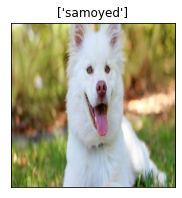

In [141]:
# check custom image prediction
plt.figure(figsize = (10,10))
for i, image in enumerate(custom_images):
  plt.subplot(1,3,i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels)
  plt.imshow(image)